<a href="https://colab.research.google.com/github/Joseph-A-Mason/Colab_notebooks/blob/main/Lake_Superior_Sentinel_gif.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook makes an animated GIF image from an Earth Engine time series image collection. It  is a modified version of a notebook by Justin Braaten (https://github.com/jdbcode); I have modified the long code block that selects data, adds a shaded relief background, calculates dates, etc. A filmstrip is created that is chopped into frames. The frames are annotated with the image date according to text position and style you define. The resulting frames are combined into an animated GIF file using the image magick utility. The final step optionally compresses the GIF.

Set up Earth Engine

In [ ]:
import ee
ee.Authenticate()
ee.Initialize(project='aeol-masonja')

Develop the image collection, in this case from Sentinel 2 SR images with less than 10 percent cloud cover between Jan 2019 and December 2021

Setting the date in the `visImg` function is important!

`.set('date', img.date().format('YYYY-MM-dd', tz)))`

In [ ]:
aoi = ee.Geometry.Polygon(
  [[-92.10, 46.8],
   [-92.10, 46.64],
   [-91.70, 46.64],
   [-91.70, 46.8]],,
    None, False)

Sent_col = (ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED')
                  .filterDate(ee.Date('2021-02-01'), ee.Date('2025-02-01'))
                  .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE',10))
                  .filterBounds(aoi))

visArgsSent = {
  'min': 0.0,
  'max': 1850.0,
  'bands': ['B4', 'B3', 'B2']
}


def visFun(img):
  return (img.visualize(**visArgsSent)
  .set('date', img.date().format('YYYY.MM.dd'))
  .copyProperties(img, img.propertyNames()))

Sent_colRGB = Sent_col.map(visFun)

dates = Sent_colRGB.aggregate_array('date').getInfo()

Generate a thumbnail filmstrip URL from the image collection

In [ ]:
from googleapiclient.model import absolute_import
filmstrip_params = {
  'dimensions': 720,
  'region': aoi,
  'crs': 'EPSG:4490',
  'framesPerSecond': 0.5
}

filmstrip_url = Sent_colRGB.getFilmstripThumbURL(filmstrip_params)

Get some packages and modules for dealing with images

In [ ]:
import urllib.request
from PIL import Image, ImageDraw, ImageFont
import glob
from IPython.display import Image as ImageGIF

Fetch the image collection thumbnail filmstrip

In [ ]:
filmstrip_name = 'filmstrip.png'
urllib.request.urlretrieve(filmstrip_url, filmstrip_name)

('filmstrip.png', <http.client.HTTPMessage at 0x7ce7e41d0e10>)

Get some info about the filmstrip

In [ ]:
filmstrip_im = Image.open(filmstrip_name)
width, height = filmstrip_im.size
crop_interval = height / len(dates)
print(width, height, crop_interval)

720 25200 360.0


Preview the first frame

<PIL.Image.Image image mode=RGBA size=720x360 at 0x7CE7E41A5AD0>


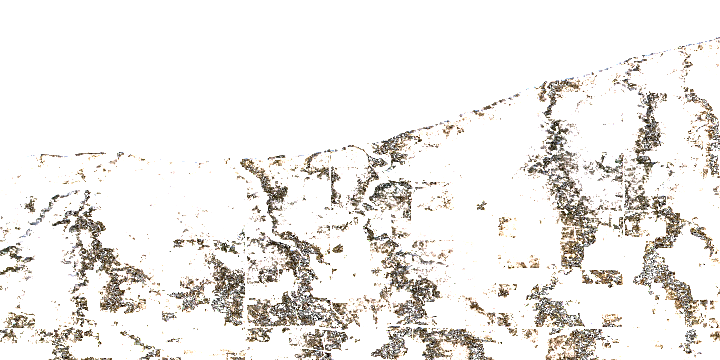

In [ ]:
frame_0 = filmstrip_im.crop((0, 0, width, crop_interval))
print(frame_0)
display(frame_0)

Get a font (Consolas)

In [ ]:
font_url = 'https://github.com/tsenart/sight/raw/master/fonts/Consolas.ttf'
font_name = 'Consolas.ttf'
urllib.request.urlretrieve(font_url, font_name)

('Consolas.ttf', <http.client.HTTPMessage at 0x7ce7e4187490>)

Figure out annotation position and size

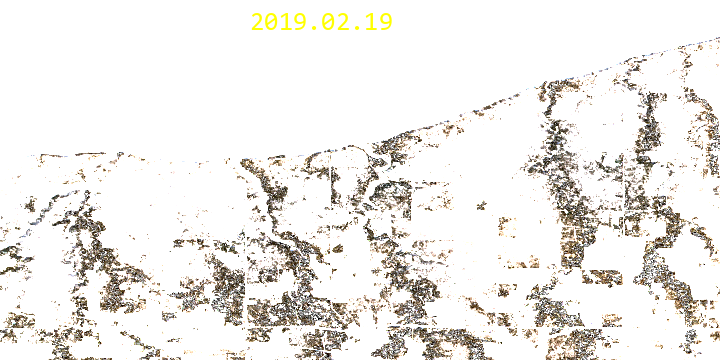

In [ ]:
right = 250
down = 10
font_size = 26
fill = '#FFFF00'

font = ImageFont.truetype(font_name, font_size)
anno_test = filmstrip_im.crop((0, 0, width, crop_interval))
ImageDraw.Draw(anno_test).text((right, down), dates[0], fill=fill, font=font)
display(anno_test)

Loop through the frames to crop and annotate

In [ ]:
for frame, date in enumerate(dates):
    frame_im = filmstrip_im.crop(
        (0, frame*crop_interval, width, (frame+1)*crop_interval))
    ImageDraw.Draw(frame_im).text((right, down), date, fill=fill, font=font)
    frame_im.save(str(frame).zfill(3)+'_frame.png')

Did it work?

Found these frames:

000_frame.png  012_frame.png  024_frame.png  036_frame.png  048_frame.png  060_frame.png
001_frame.png  013_frame.png  025_frame.png  037_frame.png  049_frame.png  061_frame.png
002_frame.png  014_frame.png  026_frame.png  038_frame.png  050_frame.png  062_frame.png
003_frame.png  015_frame.png  027_frame.png  039_frame.png  051_frame.png  063_frame.png
004_frame.png  016_frame.png  028_frame.png  040_frame.png  052_frame.png  064_frame.png
005_frame.png  017_frame.png  029_frame.png  041_frame.png  053_frame.png  065_frame.png
006_frame.png  018_frame.png  030_frame.png  042_frame.png  054_frame.png  066_frame.png
007_frame.png  019_frame.png  031_frame.png  043_frame.png  055_frame.png  067_frame.png
008_frame.png  020_frame.png  032_frame.png  044_frame.png  056_frame.png  068_frame.png
009_frame.png  021_frame.png  033_frame.png  045_frame.png  057_frame.png  069_frame.png
010_frame.png  022_frame.png  034_frame.png  046_frame.png  058_frame.png
011_frame.png  

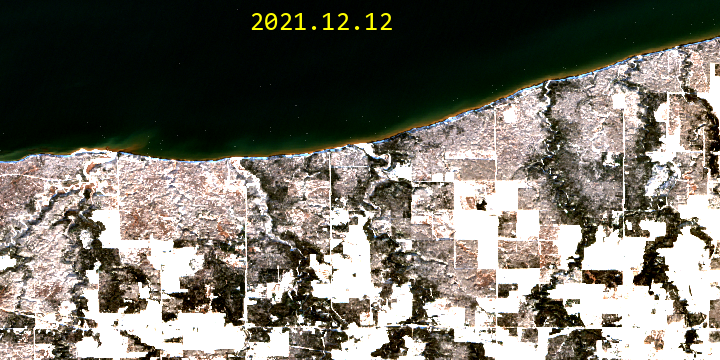

In [ ]:
print('Found these frames:\n')
!ls *_frame.png
print('\nFinal frame:\n')
Image.open(str(frame).zfill(3)+'_frame.png')

Make the GIF using ImageMagick

In [ ]:
!apt install imagemagick

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fonts-droid-fallback fonts-noto-mono fonts-urw-base35 ghostscript gsfonts imagemagick-6-common
  imagemagick-6.q16 libdjvulibre-text libdjvulibre21 libfftw3-double3 libgs9 libgs9-common libidn12
  libijs-0.35 libjbig2dec0 libjxr-tools libjxr0 liblqr-1-0 libmagickcore-6.q16-6
  libmagickcore-6.q16-6-extra libmagickwand-6.q16-6 libnetpbm10 libwmflite-0.2-7 netpbm
  poppler-data
Suggested packages:
  fonts-noto fonts-freefont-otf | fonts-freefont-ttf fonts-texgyre ghostscript-x imagemagick-doc
  autotrace cups-bsd | lpr | lprng enscript gimp gnuplot grads hp2xx html2ps libwmf-bin mplayer
  povray radiance sane-utils texlive-base-bin transfig ufraw-batch libfftw3-bin libfftw3-dev
  inkscape poppler-utils fonts-japanese-mincho | fonts-ipafont-mincho fonts-japanese-gothic
  | fonts-ipafont-gothic fonts-arphic-ukai fonts-arphic-uming fonts-nan

In [ ]:
import os

In [ ]:
gif_name = 'Hwy13b.gif'
delay = 50

cmd = f'convert -loop 0 -delay {delay} *_frame.png {gif_name}'
print(cmd)
os.system(cmd)

convert -loop 0 -delay 50 *_frame.png Hwy13.gif


0

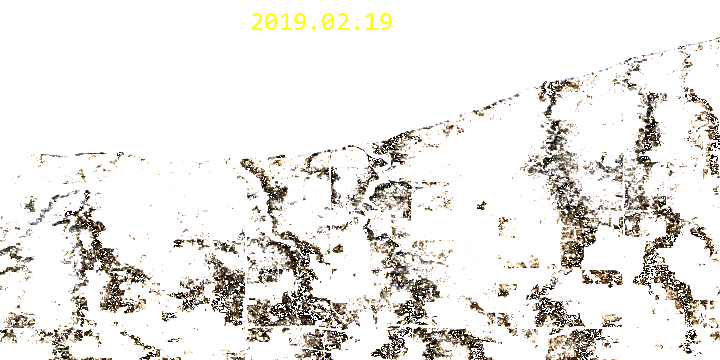

In [ ]:
with open('Hwy13b.gif','rb') as f:
    display(ImageGIF(data=f.read(), format='png'))

Compress the GIF

In [ ]:
in_gif = 'Hwy13b.gif'
out_gif = 'Hwy13b_compress.gif'
fuzz = 5  # percent

cmd = f'convert -fuzz {fuzz}% -layers Optimize {in_gif} {out_gif}'
print(cmd)
os.system(cmd)

convert -fuzz 5% -layers Optimize Hwy13.gif Hwy13_compress.gif


0

Preview the compressed version

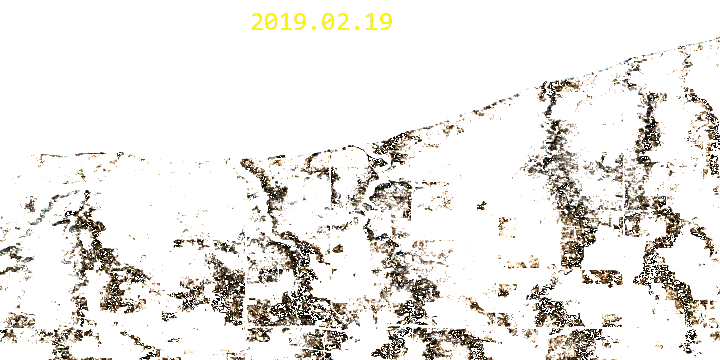

In [ ]:
with open('Hwy13b_compress.gif','rb') as f:
    display(ImageGIF(data=f.read(), format='png'))

Download the animation

In [ ]:
from google.colab import files
files.download(out_gif)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>